# WavAugment walkthrough

In this colab document, we will go through some basic functionality that WavAugment provides. We will
*  install some required packages,
*  show how to apply simple augmentations on a speech sequence,
*  how to combine and randomize them,
*  discuss some useful considerations and limitations.

Our overall target is cover most of the things that we found useful for deep self-supervised learning.

## Applying simple and useful augmentations

Let's import everything we will need.

In [3]:
import torch
import torchaudio
import torchaudio.functional as F

print(torch.__version__)
print(torchaudio.__version__)

import os
import random
import augment
import numpy as np

from IPython.display import Audio
import matplotlib.pyplot as plt

1.13.1+cu117
0.13.1+cu117


Let's load the snippet of the speech and listen to it:

In [4]:
print(os.getcwd())
print(os.listdir("../../../datasets/GTZAN/gtzan_genre/genres/blues"))

/home/oriol_colome_font_epidemicsound_/Master-Thesis-1/utils/positive generator/torchaudio tutorials
['blues.00052.wav', 'blues.00092.wav', 'blues.00093.wav', 'blues.00070.wav', 'blues.00076.wav', 'blues.00058.wav', 'blues.00098.wav', 'blues.00073.wav', 'blues.00038.wav', 'blues.00034.wav', 'blues.00069.wav', 'blues.00064.wav', 'blues.00057.wav', 'blues.00097.wav', 'blues.00007.wav', 'blues.00040.wav', 'blues.00049.wav', 'blues.00000.wav', 'blues.00027.wav', 'blues.00077.wav', 'blues.00075.wav', 'blues.00001.wav', 'blues.00063.wav', 'blues.00003.wav', 'blues.00035.wav', 'blues.00046.wav', 'blues.00082.wav', 'blues.00025.wav', 'blues.00024.wav', 'blues.00039.wav', 'blues.00088.wav', 'blues.00022.wav', 'blues.00081.wav', 'blues.00014.wav', 'blues.00026.wav', 'blues.00066.wav', 'blues.00044.wav', 'blues.00036.wav', 'blues.00094.wav', 'blues.00016.wav', 'blues.00051.wav', 'blues.00078.wav', 'blues.00020.wav', 'blues.00099.wav', 'blues.00031.wav', 'blues.00048.wav', 'blues.00002.wav', 'blue

In [5]:
root = '../../../datasets/GTZAN/gtzan_genre/genres/'
genres = ["blues", "classical", "country", "disco", "hiphop", "jazz", "metal", "pop", "reggae", "rock"]

test_list = []
for genre in genres:
    song = random.choice(os.listdir(root + genre))
    audio, sr = torchaudio.load(os.path.join(root, genre, song))
    test_list.append(['test_audio_' + str(genre), audio, sr])

print(test_list)

[['test_audio_blues', tensor([[ 0.0695,  0.1135,  0.1049,  ..., -0.1252, -0.1599, -0.1628]]), 22050], ['test_audio_classical', tensor([[-0.0246, -0.0445, -0.0443,  ..., -0.0011, -0.0009, -0.0015]]), 22050], ['test_audio_country', tensor([[-0.0303, -0.0394, -0.0493,  ...,  0.1765,  0.1611,  0.1276]]), 22050], ['test_audio_disco', tensor([[-0.4040, -0.7855, -0.3900,  ..., -0.4587, -0.4875, -0.4741]]), 22050], ['test_audio_hiphop', tensor([[-0.0050, -0.0033, -0.0052,  ..., -0.1675,  0.0563,  0.1138]]), 22050], ['test_audio_jazz', tensor([[-0.0219, -0.0391, -0.0333,  ..., -0.0354, -0.0378, -0.0327]]), 22050], ['test_audio_metal', tensor([[-0.3647, -0.3935, -0.4085,  ..., -0.1712, -0.1707, -0.1590]]), 22050], ['test_audio_pop', tensor([[ 0.0393,  0.0408,  0.0417,  ..., -0.0319, -0.0457, -0.0395]]), 22050], ['test_audio_reggae', tensor([[-0.0027, -0.0051, -0.0026,  ..., -0.1164, -0.1224, -0.1196]]), 22050], ['test_audio_rock', tensor([[ 0.1451, -0.0753, -0.3482,  ..., -0.1111, -0.0261,  0.09

In [6]:
for audio in test_list:
    print(audio[0])
    Audio(audio[1], rate=audio[2])

test_audio_blues
test_audio_classical
test_audio_country
test_audio_disco
test_audio_hiphop
test_audio_jazz
test_audio_metal
test_audio_pop
test_audio_reggae
test_audio_rock


In [7]:
def plot_waveform(waveform, sample_rate, title="Waveform", xlim=None):
    waveform = waveform.numpy()

    num_channels, num_frames = waveform.shape
    time_axis = torch.arange(0, num_frames) / sample_rate

    figure, axes = plt.subplots(num_channels, 1)
    if num_channels == 1:
        axes = [axes]
    for c in range(num_channels):
        axes[c].plot(time_axis, waveform[c], linewidth=1)
        axes[c].grid(True)
        if num_channels > 1:
            axes[c].set_ylabel(f"Channel {c+1}")
        if xlim:
            axes[c].set_xlim(xlim)
    figure.suptitle(title)
    plt.show(block=False)

In [8]:
def play_audio(waveform, sample_rate):
  waveform = waveform.numpy()

  num_channels, num_frames = waveform.shape
  if num_channels == 1:
    display(Audio(waveform[0], rate=sample_rate))
  elif num_channels == 2:
    display(Audio((waveform[0], waveform[1]), rate=sample_rate))
  else:
    raise ValueError("Waveform with more than 2 channels are not supported.")

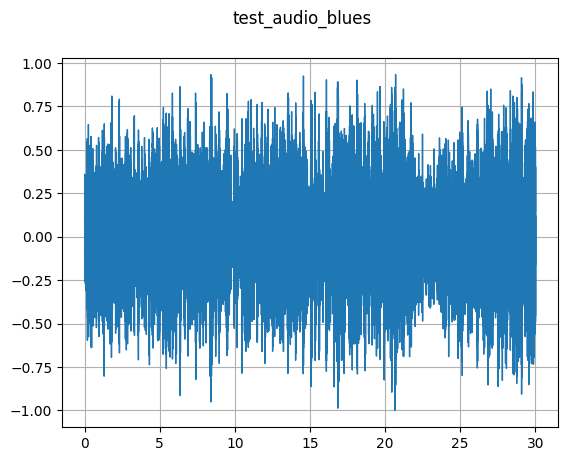

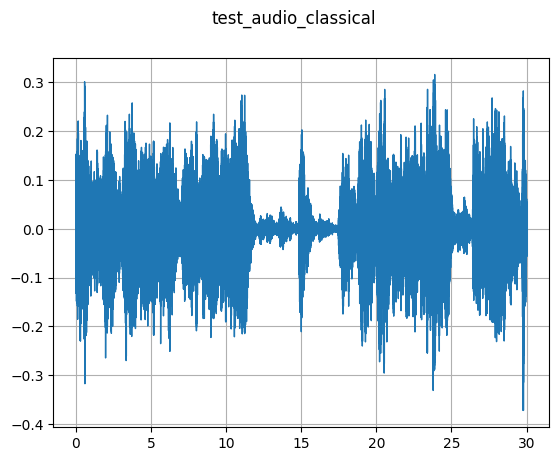

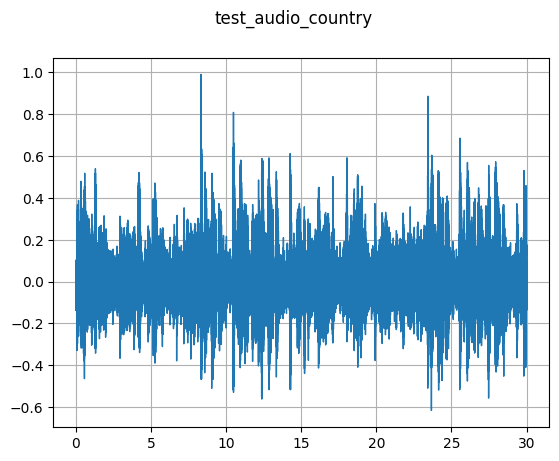

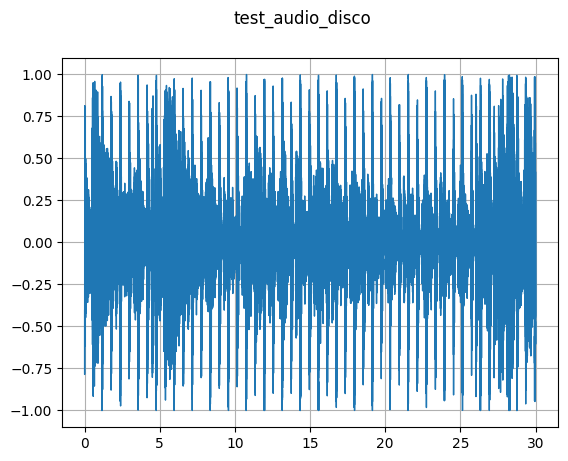

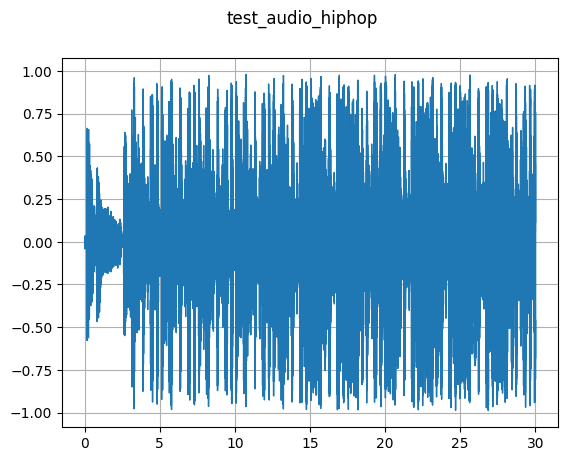

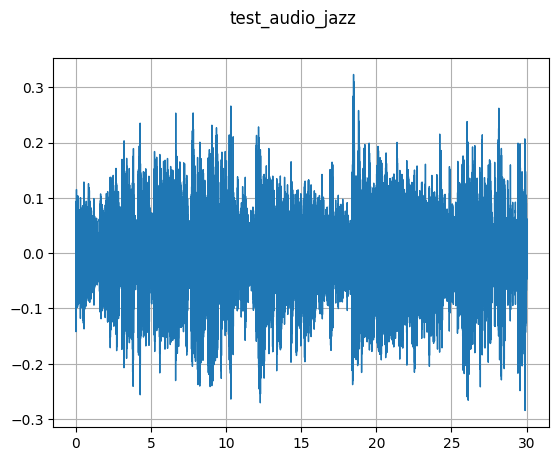

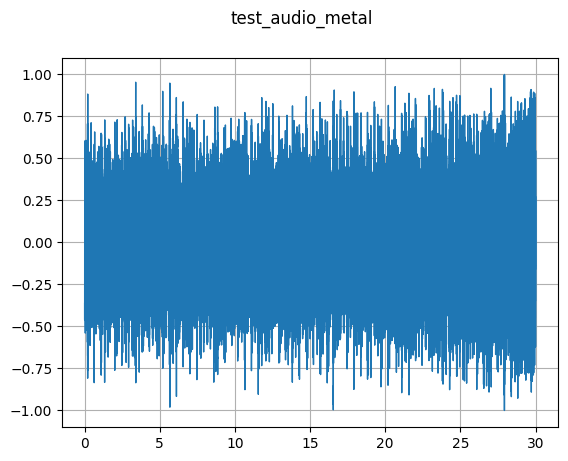

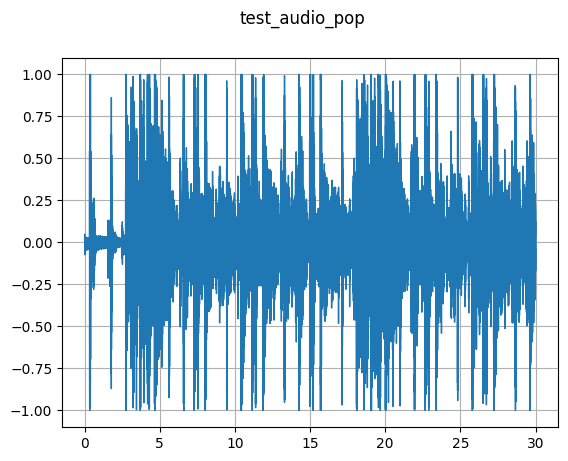

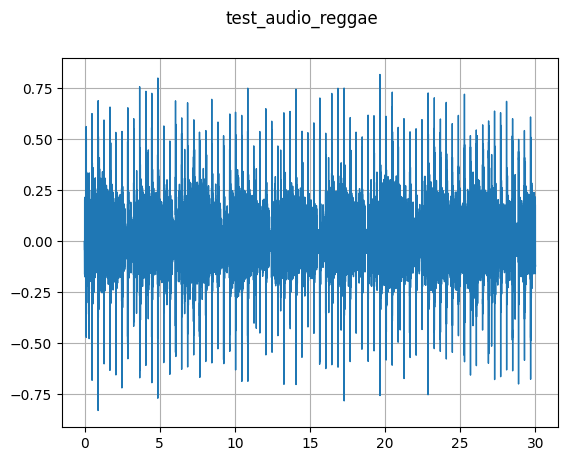

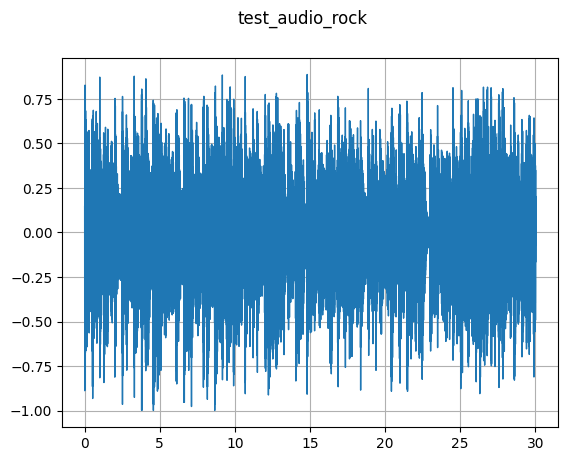

In [9]:
for i in range(len(test_list)):
    plot_waveform(test_list[i][1], test_list[i][2], title=str(test_list[i][0]), xlim=None)
    play_audio(test_list[i][1], test_list[i][2])

Similarly to `sox`, the central entity of WavAugment is a sequence of effects, `augment.EffectChain`. As the name indicates, we can create various combinations of audio effects by chaining them together. This chain can be empty and do nothing:


In [16]:
empty_chain = augment.EffectChain()
for x in test_list:
    y = empty_chain.apply(x[1], src_info={'rate': x[2]})

tensor([[ 0.0695,  0.1135,  0.1049,  ..., -0.1252, -0.1599, -0.1628]])
tensor([[-0.0246, -0.0445, -0.0443,  ..., -0.0011, -0.0009, -0.0015]])
tensor([[-0.0303, -0.0394, -0.0493,  ...,  0.1765,  0.1611,  0.1276]])
tensor([[-0.4040, -0.7855, -0.3900,  ..., -0.4587, -0.4875, -0.4741]])
tensor([[-0.0050, -0.0033, -0.0052,  ..., -0.1675,  0.0563,  0.1138]])
tensor([[-0.0219, -0.0391, -0.0333,  ..., -0.0354, -0.0378, -0.0327]])
tensor([[-0.3647, -0.3935, -0.4085,  ..., -0.1712, -0.1707, -0.1590]])
tensor([[ 0.0393,  0.0408,  0.0417,  ..., -0.0319, -0.0457, -0.0395]])
tensor([[-0.0027, -0.0051, -0.0026,  ..., -0.1164, -0.1224, -0.1196]])
tensor([[ 0.1451, -0.0753, -0.3482,  ..., -0.1111, -0.0261,  0.0907]])


or can contain one or more effects. Let us create a chain that applies a clipping effect:

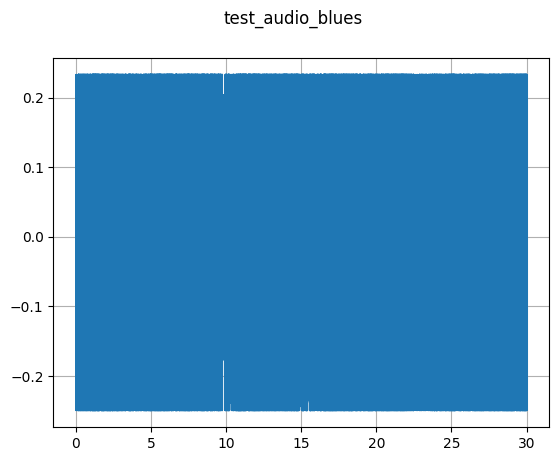

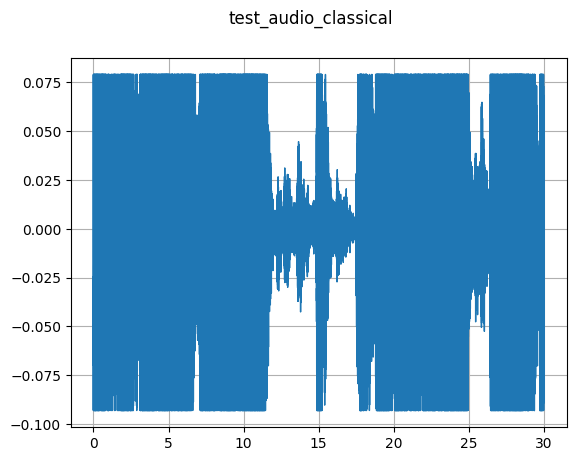

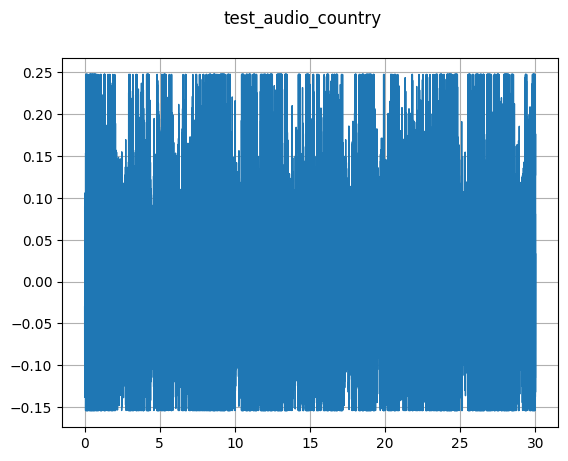

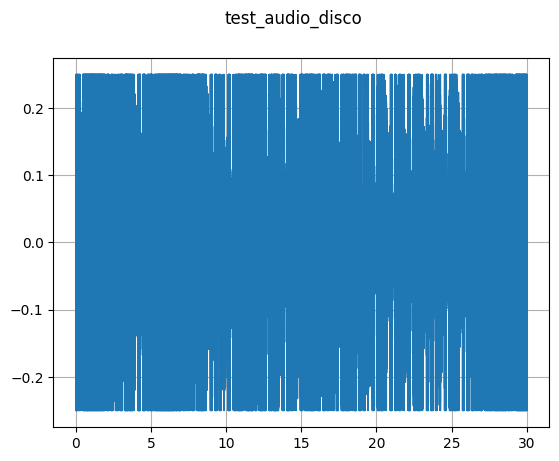

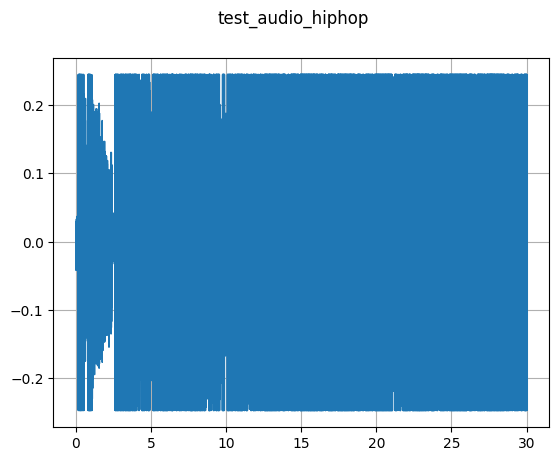

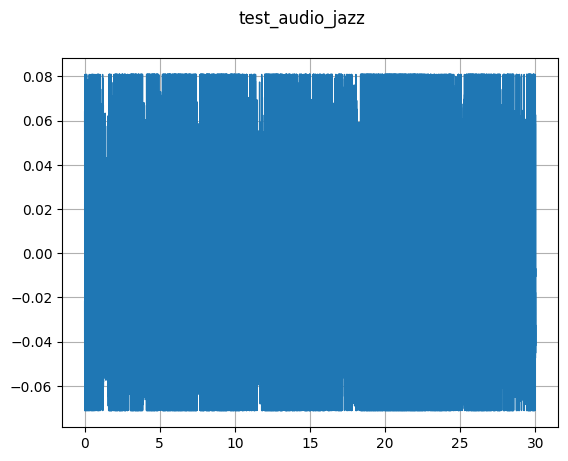

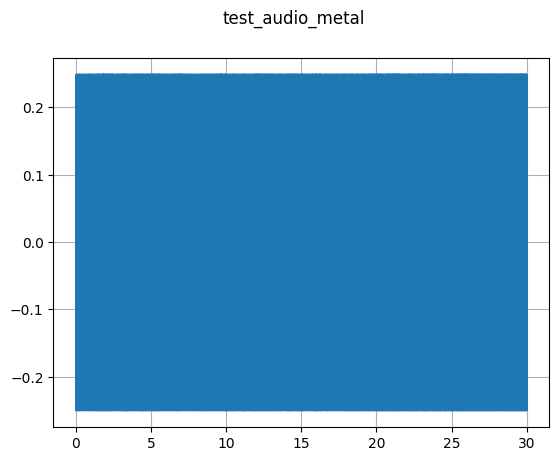

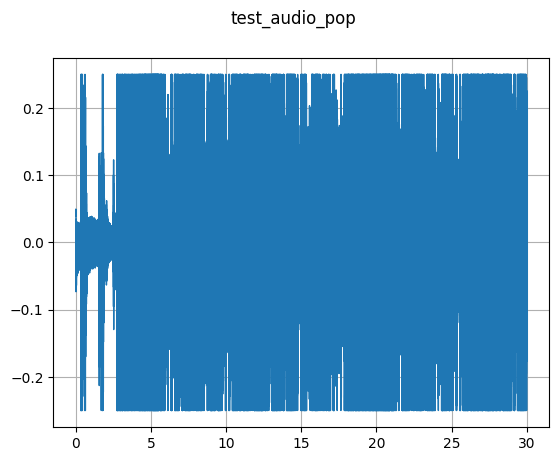

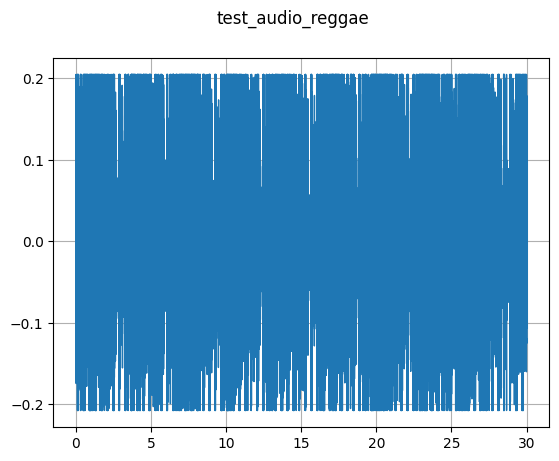

In [17]:
clip_chain = augment.EffectChain().clip(0.25)
for x in test_list:
    y = clip_chain.apply(x[1], src_info={'rate': x[2]})
    plot_waveform(y, x[2], title=str(x[0]), xlim=None)
    play_audio(y, x[2])

We can append effects one after another, just like below where we put `rate` transformer after the `pitch` one:

In [ ]:
y = augment.EffectChain().pitch(-200).rate(sr) \
  .apply(x, src_info={'rate': sr})
ipd.Audio(y, rate=sr)

Here, we have lowered the pitch of the voice by 2 tones: -200 indicates that we'll go lower by 200 cents of the tone.

Similarly, we can go up by the same amount:

In [ ]:
y = augment.EffectChain().pitch(200).rate(sr) \
  .apply(x, src_info={'rate': sr})
ipd.Audio(y, rate=sr)

Why do we to put `rate` after pitch? At the moment, WavAugment's `pitch` provides a somewhat thin wrapper around the corresponding effect of `libsox` [*]. Internally, `libsox` would represent change in the pitch as combination of `tempo` and `rate` effects; so for the time being we need to change the rate back manually.

[*] This is subject to change in the future, as we re-iterate on the library.


Another effect that we found useful is `reverb`. The reverberations that are provided by `sox` are specified by three parameters: reverberance, dumping factor, and room size. Check how it sounds:

In [ ]:
y = augment.EffectChain().reverb(50, 50, 50).channels(1).apply(x, src_info={'rate': sr})
ipd.Audio(y, rate=sr)

Again, we need to add the `channels` effect due to pecularities of `libsox`.

What else can we do? Another effect that is often used in the literature, is replacing a small span of audio with silence. We can do that, too:

In [ ]:
y = augment.EffectChain().time_dropout(max_seconds=0.5).apply(x, src_info={'rate': sr})
ipd.Audio(y, rate=sr)

Applying additive noise is a bit more involved, as we need a database of noise, such as [MUSAN](https://www.openslr.org/17/). For the sake of this small tutorial, we will use generated uniform noise. The additive noise effect consumes a Callable that returns the noise to be added: 


In [ ]:
noise_generator = lambda: torch.zeros_like(x).uniform_()

In [ ]:
y = augment.EffectChain().additive_noise(noise_generator, snr=15).apply(x, src_info={'rate': sr})
ipd.Audio(y, rate=sr)

WavAugment does not normalize the inputs, neither noise nor the input tensor, this needs to be kept in mind.

In terms of sox effects, bandreject can be implemented as follows:

In [ ]:
y = augment.EffectChain().sinc('-a', '120', '500-100').apply(x, src_info={'rate': sr})
ipd.Audio(y, rate=sr)

Still comprehensible 🙂

## Randomization & Combining

So in data augmentation we typically want to randomize the applied augmentation and/or its strength. All effects in WavAugment take a Callable as any of its parameters, which provides a way randomize the applied effect. For instance, we can randomize pitch as follows:

In [ ]:
random_pitch_shift = lambda: np.random.randint(-400, +400)
# the pitch will be changed by a shift somewhere between (-400, +400)
random_pitch_shift_effect = augment.EffectChain().pitch("-q", random_pitch_shift).rate(sr)
# -q flag enables faster, but lower quality processing

Applying it twice, we'll get different results:

In [ ]:
y = random_pitch_shift_effect.apply(x, src_info={'rate': sr})
ipd.Audio(y, rate=sr)

In [ ]:
y = random_pitch_shift_effect.apply(x, src_info={'rate': sr})
ipd.Audio(y, rate=sr)

If an effect has several parameters, we can replace all or some of them:

In [ ]:
random_room_size = lambda: np.random.randint(0, 101)
random_reverb = augment.EffectChain().reverb(50, 50, random_room_size).channels(1)

y = random_reverb.apply(x, src_info={'rate': sr})
ipd.Audio(y, rate=sr)

In [ ]:
y = random_reverb.apply(x, src_info={'rate': sr})
ipd.Audio(y, rate=sr)

We can easily stack augmentations:

In [ ]:
combination = augment.EffectChain() \
  .pitch("-q", random_pitch_shift).rate(sr) \
  .reverb(50, 50, random_room_size).channels(1) \
  .additive_noise(noise_generator, snr=15) \
  .time_dropout(max_seconds=1.0)
y = combination.apply(x, src_info={'rate': sr}, target_info={'rate': sr})
ipd.Audio(y, rate=sr)

## Discussion & Limitations

*  Currently, all augmentations are non-batched (and done on CPU). Hence, it's a good idea to apply them inside a parallelized dataloader (see our example [example](https://github.com/facebookresearch/WavAugment/blob/master/examples/python/librispeech_selfsupervised.py)),
* In some corner cases, `pitch` augmentation within libsox might return `NaN`. If this happens, it can be useful to handle this case (as we do [here](https://github.com/facebookresearch/WavAugment/blob/master/examples/python/librispeech_selfsupervised.py#L118)),
* To interpret what sox-based effects do and which parameters they take, please consult the sox [documentation](http://sox.sourceforge.net/sox.html). All effects apart from additive noise, time dropout, and clipping are based on sox,
* The full list of 64 supported effects is:

In [ ]:
augment.EffectChain.KNOWN_EFFECTS

{'additive_noise',
 'allpass',
 'band',
 'bandpass',
 'bandreject',
 'bass',
 'bend',
 'biquad',
 'channels',
 'chorus',
 'clip',
 'compand',
 'contrast',
 'dcshift',
 'deemph',
 'delay',
 'dither',
 'divide',
 'downsample',
 'earwax',
 'echo',
 'echos',
 'equalizer',
 'fade',
 'firfit',
 'flanger',
 'gain',
 'highpass',
 'hilbert',
 'input',
 'ladspa',
 'loudness',
 'lowpass',
 'mcompand',
 'noisered',
 'norm',
 'oops',
 'output',
 'overdrive',
 'pad',
 'phaser',
 'pitch',
 'rate',
 'remix',
 'repeat',
 'reverb',
 'reverse',
 'riaa',
 'silence',
 'sinc',
 'speed',
 'stat',
 'stats',
 'stretch',
 'swap',
 'synth',
 'tempo',
 'time_dropout',
 'treble',
 'tremolo',
 'trim',
 'upsample',
 'vad',
 'vol'}

Overall, we hope to extend and improve the library.